# SailGP Data Analyst Challenge

The aim is to test you python abilities. The challenge is to analyze the data provided and answer the questions below. You can use any library you want to help you with the analysis. The data is from the SailGP event in Auckland 2025. The data is in the 'DATA' folder.

There are various sources available.

The Boat Logs are in the 'Boat_Logs' folder. The data is in csv format and the columns are described in the 'Boat_Logs/Boat_Logs_Columns.csv' file.
The 'Course_Marks_2025-01-19.csv' file contains the mark positions and wind reading on the course for the whole day.

The Race_XML folder contains the xml files for each race that contains information on where the boundaries of the course are, the theoretical position of the marks and the target racecourse axis.

The 2025-01-19_man_summary.csv file contains the metrics from the manoeuvre summary for the day.
The 2025-01-19_straight_lines.csv file contains the metrics from the straight line summary for the day.

Both are derived from the boat logs.

The 2502 m8_APW_HSB2_HSRW.kph.csv file contains the polar data for the boats in that config.

## Requierements
- Chose at least 3 questions from the list below to answer.
- Python 3.8 or higher
- Notebook should be able to run without any errors from start to finish.
- Specify the libraries (imports) used in the notebook.
- Any comments to make the notebook self-explanatory and easy to follow would be appreciated.
- If you can't get to the end of a question, we would appreciate the code you have written so far and explain what you were trying to do.

## Further information:
- We usually use bokeh for visualizations. So any showcase of bokeh would be appreciated.
-

## Submitting the results.
It would be great if you could provide a jupyter notebook with the code and the results of the analysis. You can submit the results by sharing a link to a git repository.


### Imports and re-used functions
Free section to initialize the notebook with the necessary imports and functions that will be used in the notebook.



In [25]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os
import glob
from datetime import datetime, timedelta

import pyproj
grs80 = pyproj.Geod(ellps='GRS80')

from readxml import read_xml
from readpolar import read_polar, vmg_twa
import courseAnalysis as CA
import courseCalculation as CoCa

from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split

from bokeh.plotting import figure, show
from bokeh.layouts import column
from bokeh.models import LabelSet, Label, Segment
from bokeh.models import ColumnDataSource, CustomJS, DatetimeTickFormatter
from bokeh.models import Slider, RadioButtonGroup


from bokeh.io import output_notebook
output_notebook()

Loading BokehJS ...

## Question 1: Write a Python function that can take a compass direction (ie. TWD or Heading) and calculate an accurate mean value across a downsampled frequency. Eg. If TWD is at 1Hz, give me a 10s average.

### Question 1:

Created a function that downsamples the data in pandas dataframe.
Inputs of the function 'downsampledata' are the dataframe, target key to down sample, downsample freqency, and booleen option if the data is in degrees.

Tested the function with Austrarian boat data at the end.

In [2]:
def averageDegree(row):
    if np.isnan(row['temporal_sin']) or np.isnan(row['temporal_cos']):
        return np.nan
    else:
        deg = np.round(np.degrees(np.arctan2(row['temporal_sin'], row['temporal_cos'])), 2)
        if deg<0: deg += 360
        return deg

def downsampledata(df, key, frequency, degree=False):
    if degree:
        df['temporal_sin'] = df[key].apply(lambda x: np.sin(np.radians(x)))
        df['temporal_cos'] = df[key].apply(lambda x: np.cos(np.radians(x)))
    
        df['temporal_sin'] = df['temporal_sin'].rolling(frequency, center=True).mean()
        df['temporal_cos'] = df['temporal_cos'].rolling(frequency, center=True).mean()
        
        df[f'{key}_downsample'] = df.apply(averageDegree, axis=1)
        return df.drop(columns=['temporal_sin','temporal_cos'])
    else:
        df[f'{key}_downsample'] = df[key].rolling(frequency, center=True).mean()
        return df

In [3]:
df = pd.read_csv('./Data/Boat_logs/data_AUS.csv', parse_dates=[1,2])

##Fill every seconds
date_index = pd.DataFrame(pd.date_range(df['DATETIME'].iloc[0], df['DATETIME'].iloc[-1], freq='s'), columns=["DATETIME"])
df = pd.merge(date_index, df, on='DATETIME', how='left')
df = df.ffill().bfill()

df = downsampledata(df, 'TWD_SGP_deg', frequency=10, degree=True)
df[['TIME_LOCAL_unk', 'TWD_SGP_deg','TWD_SGP_deg_downsample']].tail(30)

,TIME_LOCAL_unk,TWD_SGP_deg,TWD_SGP_deg_downsample
5168,2025-01-19 17:22:16,63.54,63.01
5169,2025-01-19 17:22:17,64.05,63.28
5170,2025-01-19 17:22:18,64.36,63.53
5171,2025-01-19 17:22:19,64.40,63.72
5172,2025-01-19 17:22:20,64.19,63.83
5173,2025-01-19 17:22:21,63.98,63.86
5174,2025-01-19 17:22:22,63.78,63.78
5175,2025-01-19 17:22:23,63.60,63.54
5176,2025-01-19 17:22:24,63.44,63.19
5177,2025-01-19 17:22:25,63.28,62.77


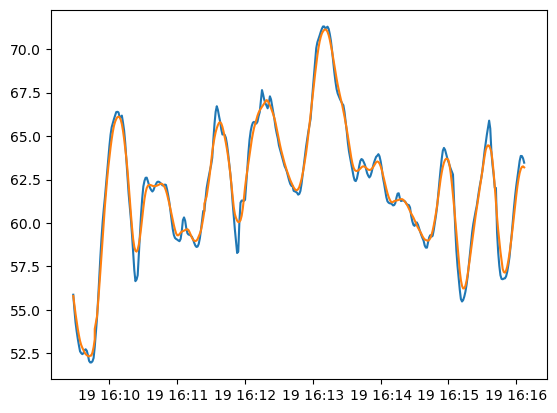

In [4]:
start_index=800
end_index=1200

plt.plot(df['TIME_LOCAL_unk'][start_index:end_index], df['TWD_SGP_deg'][start_index:end_index])
plt.plot(df['TIME_LOCAL_unk'][start_index:end_index], df['TWD_SGP_deg_downsample'][start_index:end_index])

plt.show()

## Question 2: Given a course XML and a timeseries of boat Lat/Lon values, calculate a VMC column for the same timeseries.


### Question 2:

Calculated VMC using SOG, COG, sailing LEG and the mark position at each races.

Results are stored in a dataframe, and visualized with arrows at the end.

In [5]:
def marklatlng(markpositions, mark, racenum):
    markposition = markpositions[racenum][mark]
    lat = markposition[0]
    lng = markposition[1]
    return lat, lng

In [6]:
COUNTRY_CODE = 'GBR'
RACE_DATE = '250119'
RACE_NUMBERS = [5,6,7,8]

##Read mark position data from XML file
markpositions = [read_xml(filename, read_option='Mark') for racenum in RACE_NUMBERS for filename in glob.glob(f'./Data/Race_XMLs/{RACE_DATE}0{str(racenum)}*')]


##Read boat csv data to pandas dataframe
df = pd.read_csv(f'./Data/Boat_logs/data_{COUNTRY_CODE}.csv', parse_dates=[1,2])[['TIME_LOCAL_unk', 'LATITUDE_GPS_unk', 'LONGITUDE_GPS_unk', 'GPS_SOG_km_h_1', 'GPS_COG_deg', 'TRK_LEG_NUM_unk', 'TRK_RACE_NUM_unk']]
df = df.rename(columns={'TIME_LOCAL_unk':'DATETIME',
                        'LATITUDE_GPS_unk':f'{COUNTRY_CODE}_LATITUDE',
                        'LONGITUDE_GPS_unk':f'{COUNTRY_CODE}_LONGITUDE',
                        'GPS_SOG_km_h_1':f'{COUNTRY_CODE}_GPS_SOG',
                        'GPS_COG_deg':f'{COUNTRY_CODE}_GPS_COG',
                        'TRK_RACE_NUM_unk':f'{COUNTRY_CODE}_RACE_NUMBER',
                        'TRK_LEG_NUM_unk':f'{COUNTRY_CODE}_LEG_NUMBER'})

##Fill every secounds
date_index = pd.DataFrame(pd.date_range(df['DATETIME'].iloc[0], df['DATETIME'].iloc[-1], freq='s'), columns=["DATETIME"])
df = pd.merge(date_index, df, on='DATETIME', how='left')
df = df.ffill().bfill()

##Format race number
df[f'{COUNTRY_CODE}_RACE_NUMBER'] = df[f'{COUNTRY_CODE}_RACE_NUMBER'].apply(lambda x: int(str(x)[7]))
df = df.astype({f'{COUNTRY_CODE}_RACE_NUMBER':'int', f'{COUNTRY_CODE}_LEG_NUMBER':'int'})
FirstRaceToday = df[f'{COUNTRY_CODE}_RACE_NUMBER'][0]

##Append mark position data
for mark in markpositions[0].keys():
    df[[f'{mark}_LATITUDE_deg', f'{mark}_LONGITUDE_deg']] = df.apply(lambda row: marklatlng(markpositions, mark, row[f'{COUNTRY_CODE}_RACE_NUMBER']-FirstRaceToday), axis=1, result_type='expand')

df.head()

,DATETIME,GBR_LATITUDE,GBR_LONGITUDE,GBR_GPS_SOG,GBR_GPS_COG,GBR_LEG_NUMBER,GBR_RACE_NUMBER,SL1_LATITUDE_deg,SL1_LONGITUDE_deg,SL2_LATITUDE_deg,...,LG2_LATITUDE_deg,LG2_LONGITUDE_deg,WG1_LATITUDE_deg,WG1_LONGITUDE_deg,WG2_LATITUDE_deg,WG2_LONGITUDE_deg,FL1_LATITUDE_deg,FL1_LONGITUDE_deg,FL2_LATITUDE_deg,FL2_LONGITUDE_deg
0,2025-01-19 15:59:50,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055
1,2025-01-19 15:59:51,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055
2,2025-01-19 15:59:52,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055
3,2025-01-19 15:59:53,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055
4,2025-01-19 15:59:54,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055


In [7]:
#Function to calculate the center position of a gate mark
def markCenterPos(row, mark):
    if len(mark) == 1:
        return [row[f'{mark[0]}_LATITUDE_deg'], row[f'{mark[0]}_LONGITUDE_deg']]
    elif len(mark) == 2:
        return [np.mean([row[f'{mark[0]}_LATITUDE_deg'], row[f'{mark[1]}_LATITUDE_deg']]), np.mean([row[f'{mark[0]}_LONGITUDE_deg'], row[f'{mark[1]}_LONGITUDE_deg']])]

#Fuction to calculate VMC
def vmc(df, COUNTRY_LIST):
    mark_list = [['SL1','SL2'],['M1'],['LG1','LG2'],['WG1','WG2'],['LG1','LG2'],['WG1','WG2'],['LG1'],['FL1','FL2']]
    for COUNTRY_CODE in COUNTRY_LIST:
        vmc = []
        azimuth = []
        sog = df[f'{COUNTRY_CODE}_GPS_SOG']
        cog = df[f'{COUNTRY_CODE}_GPS_COG']
        leg = df[f'{COUNTRY_CODE}_LEG_NUMBER']

        for index, row in df.iterrows():
            mark0_pos = markCenterPos(row, mark_list[leg[index]-1])
            mark1_pos = markCenterPos(row, mark_list[leg[index]])
            azi, _, _ = grs80.inv(mark0_pos[1], mark0_pos[0], mark1_pos[1], mark1_pos[0])
            vmc.append(int(sog[index] * np.cos(np.deg2rad(cog[index]-azi))))
            azimuth.append(round(azi, 2))

        append_df = pd.DataFrame([vmc, azimuth], index=[f'{COUNTRY_CODE}_VMC', f'{COUNTRY_CODE}_Mark_Angle']).T
        df = pd.concat([df, append_df], axis=1)
        print(f'Completed {COUNTRY_CODE} data')
    return df

df = vmc(df, [COUNTRY_CODE])
df.head()

Completed GBR data


,DATETIME,GBR_LATITUDE,GBR_LONGITUDE,GBR_GPS_SOG,GBR_GPS_COG,GBR_LEG_NUMBER,GBR_RACE_NUMBER,SL1_LATITUDE_deg,SL1_LONGITUDE_deg,SL2_LATITUDE_deg,...,WG1_LATITUDE_deg,WG1_LONGITUDE_deg,WG2_LATITUDE_deg,WG2_LONGITUDE_deg,FL1_LATITUDE_deg,FL1_LONGITUDE_deg,FL2_LATITUDE_deg,FL2_LONGITUDE_deg,GBR_VMC,GBR_Mark_Angle
0,2025-01-19 15:59:50,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055,-54.0,83.79
1,2025-01-19 15:59:51,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055,-54.0,83.79
2,2025-01-19 15:59:52,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055,-54.0,83.79
3,2025-01-19 15:59:53,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055,-54.0,83.79
4,2025-01-19 15:59:54,-36.829452,174.757544,54.66,265.17,0,5,-36.834644,174.769757,-36.83533,...,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055,-54.0,83.79


In [8]:
##Format data to show graphs

##Function to translate latitude,longitude data to melkart coordinates
def lonlat2m(lon: float, lat: float) -> tuple[float, float]:
    transformer = pyproj.Transformer.from_crs(4326, 3857, always_xy=True)
    x, y = transformer.transform(lon, lat)
    return x, y

##Format time
df['time'] = df['DATETIME'].apply(lambda x: x.timestamp()*1000)

##Format position data
df[f'{COUNTRY_CODE}_LONGITUDE_merc'], df[f'{COUNTRY_CODE}_LATITUDE_merc'] = lonlat2m(df[f'{COUNTRY_CODE}_LONGITUDE'], df[f'{COUNTRY_CODE}_LATITUDE'])
marktypes =  ['SL1','SL2', 'M1', 'LG1','LG2', 'WG1','WG2', 'FL1','FL2']
for mark in marktypes:
    df[f'{mark}_LONGITUDE_merc'], df[f'{mark}_LATITUDE_merc'] = lonlat2m(df[f'{mark}_LONGITUDE_deg'], df[f'{mark}_LATITUDE_deg'])

In [9]:
#Create Figure
p = figure(x_axis_type="mercator", y_axis_type="mercator", width=1000,height=500,
           x_range=(df[f'{COUNTRY_CODE}_LONGITUDE_merc'].min(), df[f'{COUNTRY_CODE}_LONGITUDE_merc'].max()),
           y_range=(df[f'{COUNTRY_CODE}_LATITUDE_merc'].min(), df[f'{COUNTRY_CODE}_LATITUDE_merc'].max()))
           #x_range=(np.min(df[f'{COUNTRY_CODE}_LONGITUDE_merc']), np.max(df[f'{COUNTRY_CODE}_LONGITUDE_merc'])),
           #y_range=(np.min(df[f'{COUNTRY_CODE}_LATITUDE_merc']), np.max(df[f'{COUNTRY_CODE}_LATITUDE_merc'])))
p.add_tile("CartoDB Positron", retina=True)

## Set trac line
tracdata = {'longitude':df[f'{COUNTRY_CODE}_LONGITUDE_merc'], 'latitude':df[f'{COUNTRY_CODE}_LATITUDE_merc']}
tracline = p.line(x='longitude', y='latitude', source=tracdata)

##Set Marks scatter
x = [df[f'{mark}_LONGITUDE_merc'][0] for mark in marktypes]
y = [df[f'{mark}_LATITUDE_merc'][0] for mark in marktypes]
markposi = p.scatter(x=x, y=y, fill_color='red', line_color='red', size=5)

## Set Current Locater
boats_data = {
    'x':[df[f'{COUNTRY_CODE}_LONGITUDE_merc'][0]],
    'y':[df[f'{COUNTRY_CODE}_LATITUDE_merc'][0]],
    'text': ['VMC: --km/h']
}
boatposi = p.scatter(x='x', y='y', source=boats_data, size=5, color="navy", alpha=0.5)
labels = LabelSet(x='x', y='y', text='text', source=ColumnDataSource(boats_data), text_font_size="10pt", x_offset=0, y_offset=0)
p.add_layout(labels)

## Set SOG Arrow 
arrowdata = vmc_arrowdata = {'x0':[0], 'y0':[0], 'x1':[0], 'y1':[0]}
headdata = vmc_headdata = {'x':[0], 'y':[0], 'angle':[0]}
arrow = p.segment(x0="x0", y0="y0", x1="x1", y1="y1", source=arrowdata, line_width=3, line_color='red')
head = p.scatter(x='x', y='y', angle='angle', source=headdata, size=12, marker="triangle", fill_color="red", line_color='red')

## Set VMC Arrow 
vmc_arrow = p.segment(x0="x0", y0="y0", x1="x1", y1="y1", source=vmc_arrowdata, line_width=3, line_color='yellow')
vmc_head = p.scatter(x='x', y='y', angle='angle', source=vmc_headdata, size=12, marker="triangle", fill_color="yellow", line_color='yellow')

## Add Slider 
slider = Slider(title="Time",
                start=df['time'].min(),
                end=df['time'].max(),
                value=df['time'].min(),
                step=1000, orientation='horizontal',
                format=DatetimeTickFormatter(years="'%Y-%m-%d %H:%M:%S"))

## Setup the slider callbacks
callback = CustomJS(args=dict(tracline=tracline.data_source,
                              markposi=markposi.data_source,
                              boatposi=boatposi.data_source,
                              labels=labels,
                              country = COUNTRY_CODE,
                              marktypes = marktypes,
                              arrow=arrow.data_source,
                              head=head.data_source,
                              vmc_arrow=vmc_arrow.data_source,
                              vmc_head=vmc_head.data_source,
                              source_origin=ColumnDataSource(df)),
                    code = open('./json/graph2.js', 'r', encoding='UTF-8').read())


slider.js_on_change('value', callback)
p.axis.visible = False
show(column(p,slider))

Red Arrow : SOG and COG direction

Yellow arrow : VMC and Course direction

## Question 3: Verify and comment on the boats calibration. If possible propose a post-calibrated set of wind numbers and a potential calibration table.


Question3:
I have looked at the difference between the TWD on port tack and starboard tack.

These boats have maximum of nearly 5 degrees difference. It's probably because of the upwash of the sail or the rotation of the instrument.

In [10]:
def differencial(deg1, deg2):
    vec1 = np.array([np.cos(np.deg2rad(deg1)), np.sin(np.deg2rad(deg1))])
    rotation = np.array([[np.cos(np.deg2rad(deg2)), np.sin(np.deg2rad(deg2))],[-np.sin(np.deg2rad(deg2)), np.cos(np.deg2rad(deg2))]])
    vec = rotation @ vec1
    return np.rad2deg(np.arctan2(vec[1], vec[0]))

def add_calibrated_TWD(df, correction_value):
    port_TWD_new=[]
    stbd_TWD_new =[]
    TWD_new=[]

    for twd, twa in zip(df.TWD_SGP_deg, df.TWA_SGP_deg):
        if twa<0:##if port
            newTWD = twd + correction_value
            port_TWD_new.append(newTWD)
        else:##elif starboard
            newTWD = twd - correction_value
            stbd_TWD_new.append(newTWD)
        TWD_new.append(newTWD)
    return port_TWD_new, stbd_TWD_new, TWD_new

In [11]:
for filename in glob.glob(f'./Data/Boat_logs/data_*.csv'):
    COUNTRY_CODE = os.path.basename(filename).split('_')[1].split('.')[0]

    #Read data from boat log csv file
    df = pd.read_csv(filename, encoding='utf-8')
    #Split TWD with port and starboard
    port_TWD = [TWD for (TWD, TWA) in zip(df.TWD_SGP_deg, df.TWA_SGP_deg) if TWA<0]
    stbd_TWD = [TWD for (TWD, TWA) in zip(df.TWD_SGP_deg, df.TWA_SGP_deg) if TWA>0]

    #Create correction table
    correction_value = differencial(np.mean(stbd_TWD) , np.mean(port_TWD))/2

    #Add new data
    port_TWD_new, stbd_TWD_new, TWD_new = add_calibrated_TWD(df, correction_value)
    df['TWD_calibrated'] = np.round(TWD_new, 2)

    print(COUNTRY_CODE)
    print('original port-stbd difference :', np.round(differencial(np.mean(stbd_TWD), np.mean(port_TWD)), 2))
    print('Correction value:', np.round(correction_value, 2))
    print('corrected port-stbd difference :', np.round(differencial(np.mean(stbd_TWD_new) , np.mean(port_TWD_new)), 2))

    print(' ')

SUI
original port-stbd difference : 3.81
Correction value: 1.91
corrected port-stbd difference : -0.0
 
ESP
original port-stbd difference : 4.08
Correction value: 2.04
corrected port-stbd difference : -0.0
 
AUS
original port-stbd difference : 4.9
Correction value: 2.45
corrected port-stbd difference : -0.0
 
BRA
original port-stbd difference : 0.39
Correction value: 0.2
corrected port-stbd difference : 0.01
 
DEN
original port-stbd difference : -0.46
Correction value: -0.23
corrected port-stbd difference : 0.0
 
ITA
original port-stbd difference : -0.76
Correction value: -0.38
corrected port-stbd difference : 0.0
 
USA
original port-stbd difference : 2.53
Correction value: 1.26
corrected port-stbd difference : -0.0
 
GBR
original port-stbd difference : 1.85
Correction value: 0.92
corrected port-stbd difference : 0.0
 
CAN
original port-stbd difference : 1.79
Correction value: 0.9
corrected port-stbd difference : -0.0
 
GER
original port-stbd difference : 3.8
Correction value: 1.9
corr

## Question 4: Given a timeseries of Lat/Lon positions and a course XML, in a Python notebook, calculate a Distance to Leader metric for each boat.

### Question 4:

Calculated distance to the leader by calculating distance to the finishline of each boat and rank orders and subtracted a number of leader boat. 

Mark log csv were used to calculate the distance of each legs.

In [12]:
##Read mark position data of a day
df = pd.read_csv('./Data/Course_Marks_2025-01-19.csv', parse_dates=[0])

marktypes = df['MARK'].unique()

time_zone = 'Pacific/Auckland'
df['DATETIME'] = df['DATETIME'].dt.tz_convert(time_zone).dt.tz_localize(None)
df.head()

,DATETIME,MARK,LATITUDE_deg,LONGITUDE_deg,TWD_deg,TWS_km_h_1
0,2025-01-19 14:00:01,FL1,-36.833966,174.767958,69.768609,34.63200
1,2025-01-19 14:00:02,FL1,-36.833969,174.767961,69.792779,34.44660
2,2025-01-19 14:00:03,FL1,-36.833971,174.767961,69.748283,34.72848
3,2025-01-19 14:00:04,FL1,-36.833973,174.767960,69.810907,35.40312
4,2025-01-19 14:00:05,FL1,-36.833976,174.767962,69.999329,35.36028


In [13]:
##Format dataframe to arrange with the datetime index

racelog_df = pd.DataFrame(df['DATETIME'].unique(), columns=['DATETIME'])

##Append Mark position and TWD data
for marktype in marktypes:
    append_df = df.query(f'MARK == "{marktype}"')
    append_df = append_df[['DATETIME','LATITUDE_deg','LONGITUDE_deg','TWD_deg']]
    append_df = append_df.rename(columns={'LATITUDE_deg':f'{marktype}_LATITUDE_deg',
                                          'LONGITUDE_deg':f'{marktype}_LONGITUDE_deg',
                                          'TWD_deg':f'{marktype}_TWD_deg'})
    racelog_df = pd.merge(racelog_df, append_df, on='DATETIME')

##Calculate the distance and azimuth of each legs on each timestamp
mark_list = [['SL1','SL2'],['M1'],['LG1','LG2'],['WG1','WG2'],['LG1','LG2'],['WG1','WG2'],['LG1'],['FL1','FL2']]
for i in range(7):
    racelog_df[f'LEG{i+1}_DISTANCE'] = racelog_df.apply(lambda x: CA.calcLegDistance(leg=i+1, row=x), axis=1)

In [14]:
##Road each boats' data

COUNTRY_LIST = []
for filename in glob.glob(f'./Data/Boat_logs/data_*.csv'):
    COUNTRY_CODE = os.path.basename(filename).split('_')[1].split('.')[0]
    COUNTRY_LIST.append(COUNTRY_CODE)

    boatlog_df = pd.read_csv(filename, parse_dates=[1,2])[['TIME_LOCAL_unk', 'LATITUDE_GPS_unk', 'LONGITUDE_GPS_unk', 'TRK_LEG_NUM_unk', 'TRK_RACE_NUM_unk']]
    boatlog_df = boatlog_df.rename(columns={'TIME_LOCAL_unk':'DATETIME',
                            'LATITUDE_GPS_unk':f'{COUNTRY_CODE}_LATITUDE',
                            'LONGITUDE_GPS_unk':f'{COUNTRY_CODE}_LONGITUDE',
                            'TRK_RACE_NUM_unk':f'{COUNTRY_CODE}_RACE_NUMBER',
                            'TRK_LEG_NUM_unk':f'{COUNTRY_CODE}_LEG_NUMBER'})
    boatlog_df[f'{COUNTRY_CODE}_RACE_NUMBER'] = boatlog_df[f'{COUNTRY_CODE}_RACE_NUMBER'].apply(lambda x: int(str(x)[7]))

    ##merge boat data to the main dataframe
    racelog_df = pd.merge(racelog_df, boatlog_df, on='DATETIME', how='left')


for COUNTRY_CODE in COUNTRY_LIST:
    racelog_df[f'{COUNTRY_CODE}_LEG_NUMBER'] = racelog_df[f'{COUNTRY_CODE}_LEG_NUMBER'].bfill().fillna(0)

#Calculate distance to the leader
racelog_df = CA.distance2leader(racelog_df, COUNTRY_LIST)

In [15]:
##Format data to show the bokeh graph
def lonlat2m(lon: float, lat: float) -> tuple[float, float]:
    transformer = pyproj.Transformer.from_crs(4326, 3857, always_xy=True)
    x, y = transformer.transform(lon, lat)
    return x, y

for mark in marktypes:
    racelog_df[f'{mark}_LONGITUDE_merc'], racelog_df[f'{mark}_LATITUDE_merc'] = lonlat2m(racelog_df[f'{mark}_LONGITUDE_deg'], racelog_df[f'{mark}_LATITUDE_deg'])

for COUNTRY_CODE in COUNTRY_LIST:
    racelog_df[f'{COUNTRY_CODE}_LONGITUDE_merc'], racelog_df[f'{COUNTRY_CODE}_LATITUDE_merc'] = lonlat2m(racelog_df[f'{COUNTRY_CODE}_LONGITUDE'], racelog_df[f'{COUNTRY_CODE}_LATITUDE'])

racelog_df['time'] = pd.to_datetime(racelog_df['DATETIME'])
racelog_df['time'] = racelog_df['time'].apply(lambda x: x.timestamp()*1000)

In [16]:
source = ColumnDataSource(racelog_df)

#Create Figure and track line
p = figure(x_axis_type="mercator", y_axis_type="mercator", width=1000,height=500,
           x_range=(racelog_df['AUS_LONGITUDE_merc'].min(), racelog_df['AUS_LONGITUDE_merc'].max()),
           y_range=(racelog_df['AUS_LATITUDE_merc'].min(), racelog_df['AUS_LATITUDE_merc'].max()))
p.add_tile("CartoDB Positron", retina=True)
tracline = p.line(x='AUS_LONGITUDE_merc', y='AUS_LATITUDE_merc', source=source)

##Set Marks scatter to the figure
x = [racelog_df[f'{mark}_LONGITUDE_merc'][0] for mark in marktypes]
y = [racelog_df[f'{mark}_LATITUDE_merc'][0] for mark in marktypes]
markposi = p.scatter(x=x, y=y, fill_color='red', line_color='red', size=5)

## Set Current Locater to the figure
centerid = int(len(source.data['AUS_LONGITUDE_merc'])/2)
boats_data = {
    'x':[source.data[f'{COUNTRY_CODE}_LONGITUDE_merc'][centerid] for COUNTRY_CODE in COUNTRY_LIST],
    'y':[source.data[f'{COUNTRY_CODE}_LATITUDE_merc'][centerid] for COUNTRY_CODE in COUNTRY_LIST],
    'text': [COUNTRY_CODE+': '+str(source.data[f'{COUNTRY_CODE}_Distance2Leader'][centerid])+'m' for COUNTRY_CODE in COUNTRY_LIST]#_Distance2Leader
}
boatposi = p.scatter(x='x', y='y', source=ColumnDataSource(boats_data), size=5, color="navy", alpha=0.5)#_LEG
labels = LabelSet(x='x', y='y', text='text', source=ColumnDataSource(boats_data), text_font_size="10pt", x_offset=0, y_offset=0)
p.add_layout(labels)

## Add Slider to the figure
slider = Slider(title="Slider",
                start=racelog_df['time'].min(),
                end=racelog_df['time'].max(),
                value=racelog_df['time'].min(),
                width_policy='max',
                step=1000, orientation='horizontal',
                format=DatetimeTickFormatter(years="'%Y-%m-%d %H:%M:%S"))

## Setup the slider callbacks
callback = CustomJS(args=dict(tracline=tracline.data_source,
                              boatposi=boatposi.data_source,
                              markposi=markposi.data_source,
                              labels=labels,
                              marktypes = marktypes,
                              countrylist = COUNTRY_LIST,
                              source=ColumnDataSource(racelog_df)),
                    code= open('./json/graph4.js', 'r', encoding='UTF-8').read())

slider.js_on_change('value', callback)
p.axis.visible = False
show(column(p, slider))

## Question 5: Given a course XML, along with a wind speed and direction and a polar, calculate the minimum number of tacks or gybes for each leg of the course and each gate mark on the leg.

### Question 5:

Calculated minimum number of maneuvers by,
1. drawing a straight line from the original mark
2. tacking (or jybing) if leached to the layline or the boundary
3. Continue tacking untill the boat is being on the correct direction of tack to round the next mark

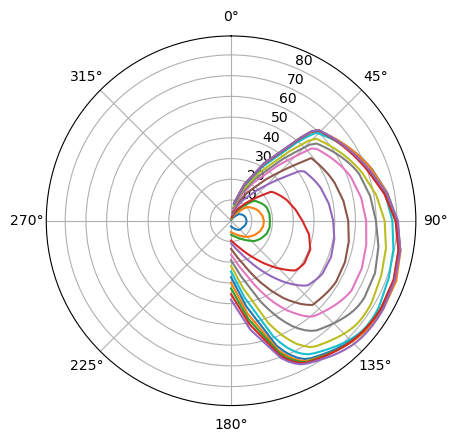

array(148.54054054)

In [21]:
filename = './Data/2502 m8_APW_HSB2_HSRW.kph.csv'
df = read_polar(filename)

##Show polar graph
ax = plt.subplot(111, projection="polar")
for tws in [x for x in df.columns.values if len(x.split('_'))==1]:
    ax.plot(np.deg2rad(df.index.values), df[tws])
ax.set_theta_zero_location('N')
ax.set_theta_direction(-1)
plt.show()

f_upwind, f_downwind = vmg_twa(df)
f_downwind(30)

In [22]:
def optimal_course(azimuth, vecs, current_position, current_tack, targetmark_position, roundway, target_mark, boundaries):
    total_maneuver = 0
    draw_layline = False
    courselines = np.array([current_position], dtype='float64')
    
    for x in range(5):
        ##Determine mark direction
        LEGs, on_laylines = CoCa.determin_markDirection(targetmark_position, courselines[-1], vecs)

        if on_laylines[targetmark]:
            courselines = np.append(courselines, [targetmark_position[targetmark]], axis=0)
            ##if on layline of the oposite tack
            if current_tack != LEGs[targetmark]:
                current_tack, total_maneuver = CoCa.manuever(current_tack, total_maneuver)
            ##if rounding direction is oposite 
            if current_tack != roundway[targetmark]:
                current_tack, total_maneuver = CoCa.manuever(current_tack, total_maneuver)
            ##if fetched from the beggining
            if not draw_layline: laylines = {f'{targetmark}_{current_tack}': courselines}
            return laylines, courselines, total_maneuver
        else:
            ThisLeg = LEGs[targetmark]##up or down
            
        #draw layline on the begining
        if not draw_layline:
            laylines = CoCa.drawLayline(targetmark_position, ThisLeg, azimuth, boundaries)
            draw_layline = True
    
        ##Check cross with layline
        #laylinecheck = check_laylinecross(current_tack, ThisLeg, targetmark_position, courselines, boundaries)
        laylinecheck = {'cross':[], 'crosspoint':[], 's':[]}
        laylinetack = 'port' if current_tack == 'stbd' else 'stbd'
        for key in laylinecheck.keys():
            laylinecheck[key] = [CoCa.determin_cross(courselines[-1], azimuth[f"{ThisLeg}_{current_tack}"], laylines[f'{mark}_{laylinetack}'])[key] 
                                 for mark in targetmark_position.keys()]
        if True in laylinecheck['cross']:
            s_list = [s for check, s in zip(laylinecheck['cross'],laylinecheck['s']) if check==True]
            crosspointlist = [crosspoint for check, crosspoint in zip(laylinecheck['cross'],laylinecheck['crosspoint']) if check==True]
            s_ranking = np.argsort(np.array(s_list))
            courselines = np.append(courselines, [crosspointlist[s_ranking[0]]], axis=0)
            current_tack, total_maneuver = CoCa.manuever(current_tack, total_maneuver)
            continue

        ##Check cross with boundary
        for i in range(len(boundaries)-1):
            cross_data = CoCa.determin_cross(courselines[-1], azimuth[f"{ThisLeg}_{current_tack}"], boundaries[i:i+2])
            if cross_data['cross']:#cross_boundary:
                courselines = np.append(courselines, [cross_data['crosspoint']], axis=0)
                current_tack, total_maneuver = CoCa.manuever(current_tack, total_maneuver)
                break
    return laylines, courselines, total_maneuver

In [23]:
xml_file = './Data/Race_XMLs/25011905_03-13-55.xml'
markpositions = read_xml(xml_file, read_option='Mark')
boundarypositions = read_xml(xml_file, read_option='Boundary')

mark_list = [['SL1','SL2'],['M1'],['LG1','LG2'],['WG1','WG2'],['LG1','LG2'],['WG1','WG2'],['LG1'],['FL1','FL2']]
roundingdata = {
    'SL1': 'stbd',
    'SL2': 'stbd',
    'M1': 'stbd', ##LEG1
    'LG1': 'port', ##LEG2, 4, 6
    'LG2': 'stbd', ##LEG2, 4, 6
    'WG1': 'port', ##LEG3, 5
    'WG2': 'stbd', ##LEG3, 5
    'FL1': 'stbd', ##LEG7
    'FL2': 'port'  ##LEG7
}

###=========== PLEASE SET THESE VALUES  ===============

LEG = 3
currentmark = 'LG1'
targetmark = 'WG2'
TWD = 60#degrees
TWS = 32.6#km/h

###====================================================

CURRENT_POSITION = markpositions[currentmark]
CURRENT_TACK = roundingdata[currentmark]
TARGET_MARKS = {mark:markpositions[mark] for mark in mark_list[LEG] }
ROUNDING_WAY = {mark:roundingdata[mark] for mark in mark_list[LEG] }

if not targetmark in TARGET_MARKS:
    print('error: targetmark is not in LEG',LEG)

azimuth, vecs = CoCa.UpwindDownwindVectors(f_upwind, f_downwind, TWD, TWS)
laylines, courselines, total_manuever = optimal_course(azimuth, vecs, CURRENT_POSITION, CURRENT_TACK, TARGET_MARKS, ROUNDING_WAY, targetmark, boundarypositions)
print(' ')
print('Number of manuevers: ',total_manuever)

 
Number of manuevers:  3


In [26]:
def lonlat2m(lon: float, lat: float) -> tuple[float, float]:
    transformer = pyproj.Transformer.from_crs(4326, 3857, always_xy=True)
    x, y = transformer.transform(lon, lat)
    return x, y

#Create Figure
p = figure(x_axis_type="mercator", y_axis_type="mercator", width=1000,height=500)
p.add_tile("CartoDB Positron", retina=True)

#Draw layline
layline_lng, layline_lat = lonlat2m(np.array([latlon[:,1] for latlon in laylines.values()]).flatten(), np.array([latlon[:,0] for latlon in laylines.values()]).flatten())
laylinedata = {'x':layline_lng[::2],'y':layline_lat[::2], 'x1':layline_lng[1::2],'y1':layline_lat[1::2]}
laylinesegment = Segment(x0='x', y0='y', x1='x1', y1='y1', line_width=2, line_color='green', line_dash='dotted')
p.add_glyph(ColumnDataSource(laylinedata), laylinesegment)

#Draw course Line
courseline_lng, courseline_lat = lonlat2m(courselines[:,1], courselines[:,0])
courselinedata = {'x':[x for x in courseline_lng[:-1]],
                  'y':[y for y in courseline_lat[:-1]], 
                  'x1':[x for x in courseline_lng[1:]],
                  'y1':[y for y in courseline_lat[1:]]}
laylinesegment = Segment(x0='x', y0='y', x1='x1', y1='y1', line_width=2, line_color='red')
p.add_glyph(ColumnDataSource(courselinedata), laylinesegment)

##Set Boundary lines
boundarydata = {'x':boundarypositions[:,1],'y':boundarypositions[:,0]}
boundarydata['x'], boundarydata['y'] = lonlat2m(boundarydata['x'], boundarydata['y'])
boundaryline = p.line(x='x', y='y', source=ColumnDataSource(boundarydata), line_width=2)


##Draw Mark plots
markdata = {'x':[latlon[1] for latlon in markpositions.values()], 'y':[latlon[0] for latlon in markpositions.values()]}
markdata['x'], markdata['y'] = lonlat2m(markdata['x'], markdata['y'])
markplots = p.scatter(x='x', y='y', source=ColumnDataSource(markdata), fill_color='red', size=5)

##Add Text
textdata = {'x':[latlon[1] for latlon in TARGET_MARKS.values()],
            'y':[latlon[0] for latlon in TARGET_MARKS.values()],
            'text':['TARGET MARK' for i in range(len(TARGET_MARKS))]}
textdata['x'], textdata['y'] = lonlat2m(textdata['x'], textdata['y'])
labels = LabelSet(x='x', y='y', text='text', source=ColumnDataSource(textdata), text_font_size="10pt", x_offset=0, y_offset=0)
p.add_layout(labels)

p.axis.visible = False
show(p)

In [27]:
###=========== PLEASE SET THESE VALUES  ===============

TWD = 70#degrees
TWS = 32.6#km/h

###====================================================

for i in range(1,8):
    LEG = i
    current_marks = mark_list[i-1]
    target_marks = mark_list[i]
    for currentmark in current_marks:
        for targetmark in target_marks:
            print('LEG',LEG, ' CURRENT MARK:',currentmark, ' TARGET MARK', targetmark)

            CURRENT_POSITION = markpositions[currentmark]
            CURRENT_TACK = roundingdata[currentmark]
            TARGET_MARKS = {mark:markpositions[mark] for mark in target_marks }
            ROUNDING_WAY = {mark:roundingdata[mark] for mark in target_marks }

            azimuth, vecs = CoCa.UpwindDownwindVectors(f_upwind, f_downwind, TWD, TWS)
            laylines, courselines, total_manuever = optimal_course(azimuth, vecs, CURRENT_POSITION, CURRENT_TACK, TARGET_MARKS, ROUNDING_WAY, targetmark, boundarypositions)

            print('Minumum number of manuver:', total_manuever)
            print(' ')

LEG 1  CURRENT MARK: SL1  TARGET MARK M1
Minumum number of manuver: 0
 
LEG 1  CURRENT MARK: SL2  TARGET MARK M1
Minumum number of manuver: 0
 
LEG 2  CURRENT MARK: M1  TARGET MARK LG1
Minumum number of manuver: 1
 
LEG 2  CURRENT MARK: M1  TARGET MARK LG2
Minumum number of manuver: 2
 
LEG 3  CURRENT MARK: LG1  TARGET MARK WG1
Minumum number of manuver: 2
 
LEG 3  CURRENT MARK: LG1  TARGET MARK WG2
Minumum number of manuver: 3
 
LEG 3  CURRENT MARK: LG2  TARGET MARK WG1
Minumum number of manuver: 3
 
LEG 3  CURRENT MARK: LG2  TARGET MARK WG2
Minumum number of manuver: 2
 
LEG 4  CURRENT MARK: WG1  TARGET MARK LG1
Minumum number of manuver: 2
 
LEG 4  CURRENT MARK: WG1  TARGET MARK LG2
Minumum number of manuver: 1
 
LEG 4  CURRENT MARK: WG2  TARGET MARK LG1
Minumum number of manuver: 1
 
LEG 4  CURRENT MARK: WG2  TARGET MARK LG2
Minumum number of manuver: 2
 
LEG 5  CURRENT MARK: LG1  TARGET MARK WG1
Minumum number of manuver: 2
 
LEG 5  CURRENT MARK: LG1  TARGET MARK WG2
Minumum numbe

## Question 6: Calculate a “tacked” set of variables depending on the tack of the boat, so that sailors don’t need to think about what tack they’re on when looking at measurements. And show the results in a visualisation.


### Question 6:

I have focused on the coulmns which includes P (port) or S (starboard) in the name.

Picked up columns are as blow;

'LENGTH_RH', 'ANGLE_DB_RAKE', 'ANGLE_DB_CANT'

I have sorted these numbers out based on the AWA numbers positive or negative.

Demonstrated the ride hight data with the track of the boat at the end. It's showing that the windward numbers are always showing the numbers from the windward side, and vice versa. 

In [28]:
COUNTRY_CODE = 'GER'
RACE_DATE = '250119'
RACE_NUMBERS = [5,6,7,8]

##Read mark position data from XML file
markpositions = [read_xml(filename, read_option='Mark') for racenum in RACE_NUMBERS for filename in glob.glob(f'./Data/Race_XMLs/{RACE_DATE}0{str(racenum)}*')]

##Read boat csv data to pandas dataframe
df = pd.read_csv(f'./Data/Boat_logs/data_{COUNTRY_CODE}.csv', parse_dates=[1,2])#[['TIME_LOCAL_unk', 'LATITUDE_GPS_unk', 'LONGITUDE_GPS_unk', 'GPS_SOG_km_h_1', 'GPS_COG_deg', 'TRK_LEG_NUM_unk', 'TRK_RACE_NUM_unk']]
df = df.drop(['DATETIME'], axis=1)
df = df.rename(columns={'TIME_LOCAL_unk':'DATETIME',
                        'LATITUDE_GPS_unk':f'{COUNTRY_CODE}_LATITUDE',
                        'LONGITUDE_GPS_unk':f'{COUNTRY_CODE}_LONGITUDE',
                        #'GPS_SOG_km_h_1':f'{COUNTRY_CODE}_GPS_SOG',
                        #'GPS_COG_deg':f'{COUNTRY_CODE}_GPS_COG',
                        'TRK_RACE_NUM_unk':f'{COUNTRY_CODE}_RACE_NUMBER',
                        'TRK_LEG_NUM_unk':f'{COUNTRY_CODE}_LEG_NUMBER'})

##Fill every secounds
date_index = pd.DataFrame(pd.date_range(df['DATETIME'].iloc[0], df['DATETIME'].iloc[-1], freq='s'), columns=["DATETIME"])
df = pd.merge(date_index, df, on='DATETIME', how='left')
df = df.ffill().bfill()

##Format race number
df[f'{COUNTRY_CODE}_RACE_NUMBER'] = df[f'{COUNTRY_CODE}_RACE_NUMBER'].apply(lambda x: int(str(x)[7]))
df = df.astype({f'{COUNTRY_CODE}_RACE_NUMBER':'int', f'{COUNTRY_CODE}_LEG_NUMBER':'int'})
FirstRaceToday = df[f'{COUNTRY_CODE}_RACE_NUMBER'][0]


##Append mark position data
for mark in markpositions[0].keys():
    df[[f'{mark}_LATITUDE_deg', f'{mark}_LONGITUDE_deg']] = df.apply(lambda row: marklatlng(markpositions, mark, row[f'{COUNTRY_CODE}_RACE_NUMBER']-FirstRaceToday), axis=1, result_type='expand')

df.head()

,DATETIME,BOAT,GER_LATITUDE,GER_LONGITUDE,BOAT_SPEED_km_h_1,GPS_SOG_km_h_1,HEADING_deg,TWA_SGP_deg,TWS_SGP_km_h_1,TWD_SGP_deg,...,LG2_LATITUDE_deg,LG2_LONGITUDE_deg,WG1_LATITUDE_deg,WG1_LONGITUDE_deg,WG2_LATITUDE_deg,WG2_LONGITUDE_deg,FL1_LATITUDE_deg,FL1_LONGITUDE_deg,FL2_LATITUDE_deg,FL2_LONGITUDE_deg
0,2025-01-19 16:06:01,GER,-36.833130,174.759390,27.04,29.25,107.50,-55.00,34.35,56.98,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055
1,2025-01-19 16:06:02,GER,-36.833155,174.759478,27.74,30.17,109.40,-56.26,34.54,56.68,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055
2,2025-01-19 16:06:03,GER,-36.833185,174.759565,27.97,30.05,113.39,-59.80,34.58,56.36,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055
3,2025-01-19 16:06:04,GER,-36.833220,174.759650,29.06,30.94,119.62,-60.15,34.36,56.25,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055
4,2025-01-19 16:06:05,GER,-36.833264,174.759735,31.61,33.20,126.00,-64.92,34.23,56.27,...,-36.832976,174.753778,-36.830518,174.767965,-36.82907,174.767251,-36.836315,174.758068,-36.835426,174.759055


In [29]:
## Rename the columns to easily query
column_list = ['LENGTH_RH', 'ANGLE_DB_RAKE', 'ANGLE_DB_CANT']
key_list = [list(filter(lambda x: x.startswith(col+f'_{tack}_'), df.columns.values))[0] for col in column_list for tack in ['P', 'S']]
value_list = [key.split('_P_')[0] + '_port' if '_P_' in key else key.split('_S_')[0] + '_starboard' for key in key_list ]
renamedict = dict(zip(key_list, value_list))

df = df.rename(columns=renamedict)

In [30]:
##Initialize list
data = {}
for col in column_list:
        data[col + '_windward'] = []
        data[col + '_leeward'] = []

##Split port and starbord with windward and leeward
for i, row in df.iterrows():
    #PORT TACK
    if row['TWA_SGP_deg']<0:
        for col in column_list:
            check_column = list(filter(lambda x: x.startswith(col+'_port'), df.columns.values))
            data[col + '_windward'].append(row[check_column[0]])
            check_column = list(filter(lambda x: x.startswith(col+'_star'), df.columns.values))
            data[col + '_leeward'].append(row[check_column[0]])
    else:
        for col in column_list:
            check_column = list(filter(lambda x: x.startswith(col+'_port'), df.columns.values))
            data[col + '_leeward'].append(row[check_column[0]])
            check_column = list(filter(lambda x: x.startswith(col+'_star'), df.columns.values))
            data[col + '_windward'].append(row[check_column[0]])

append_df = pd.DataFrame(data)
df = pd.concat([df ,append_df], axis=1)
df.head()

,DATETIME,BOAT,GER_LATITUDE,GER_LONGITUDE,BOAT_SPEED_km_h_1,GPS_SOG_km_h_1,HEADING_deg,TWA_SGP_deg,TWS_SGP_km_h_1,TWD_SGP_deg,...,FL1_LATITUDE_deg,FL1_LONGITUDE_deg,FL2_LATITUDE_deg,FL2_LONGITUDE_deg,LENGTH_RH_windward,LENGTH_RH_leeward,ANGLE_DB_RAKE_windward,ANGLE_DB_RAKE_leeward,ANGLE_DB_CANT_windward,ANGLE_DB_CANT_leeward
0,2025-01-19 16:06:01,GER,-36.833130,174.759390,27.04,29.25,107.50,-55.00,34.35,56.98,...,-36.836315,174.758068,-36.835426,174.759055,458.76,101.82,4.99,7.75,3.05,5.87
1,2025-01-19 16:06:02,GER,-36.833155,174.759478,27.74,30.17,109.40,-56.26,34.54,56.68,...,-36.836315,174.758068,-36.835426,174.759055,349.86,143.69,4.99,7.75,3.05,5.85
2,2025-01-19 16:06:03,GER,-36.833185,174.759565,27.97,30.05,113.39,-59.80,34.58,56.36,...,-36.836315,174.758068,-36.835426,174.759055,380.17,180.83,4.99,7.75,3.05,5.84
3,2025-01-19 16:06:04,GER,-36.833220,174.759650,29.06,30.94,119.62,-60.15,34.36,56.25,...,-36.836315,174.758068,-36.835426,174.759055,199.09,-100.60,4.99,7.75,3.05,5.86
4,2025-01-19 16:06:05,GER,-36.833264,174.759735,31.61,33.20,126.00,-64.92,34.23,56.27,...,-36.836315,174.758068,-36.835426,174.759055,290.86,105.40,4.99,7.76,3.05,5.86


In [31]:
##Format data to show graphs
def lonlat2m(lon: float, lat: float) -> tuple[float, float]:
    transformer = pyproj.Transformer.from_crs(4326, 3857, always_xy=True)
    x, y = transformer.transform(lon, lat)
    return x, y

##Format time
df['time'] = df['DATETIME'].apply(lambda x: x.timestamp()*1000)

##Format position data
df[f'{COUNTRY_CODE}_LONGITUDE_merc'], df[f'{COUNTRY_CODE}_LATITUDE_merc'] = lonlat2m(df[f'{COUNTRY_CODE}_LONGITUDE'], df[f'{COUNTRY_CODE}_LATITUDE'])
marktypes =  ['SL1','SL2', 'M1', 'LG1','LG2', 'WG1','WG2', 'FL1','FL2']
for mark in marktypes:
    df[f'{mark}_LONGITUDE_merc'], df[f'{mark}_LATITUDE_merc'] = lonlat2m(df[f'{mark}_LONGITUDE_deg'], df[f'{mark}_LATITUDE_deg'])

In [32]:
#Create Figure and track line
p = figure(x_axis_type="mercator", y_axis_type="mercator", width=1000,height=500,
           x_range=(df[f'{COUNTRY_CODE}_LONGITUDE_merc'].min(), df[f'{COUNTRY_CODE}_LONGITUDE_merc'].max()),
           y_range=(df[f'{COUNTRY_CODE}_LATITUDE_merc'].min(), df[f'{COUNTRY_CODE}_LATITUDE_merc'].max()))
p.add_tile("CartoDB Positron", retina=True)

## Set trac line to the figure
tracdata = {'longitude':df[f'{COUNTRY_CODE}_LONGITUDE_merc'], 'latitude':df[f'{COUNTRY_CODE}_LATITUDE_merc']}
tracline = p.line(x='longitude', y='latitude', source=tracdata)

##Set Marks scatter to the figure
x = [df[f'{mark}_LONGITUDE_merc'][0] for mark in marktypes]
y = [df[f'{mark}_LATITUDE_merc'][0] for mark in marktypes]
markposi = p.scatter(x=x, y=y, fill_color='red', line_color='red', size=5)

## Set Current Locater to the figure
boats_data = {
    'x':[df[f'{COUNTRY_CODE}_LONGITUDE_merc'][0]],
    'y':[df[f'{COUNTRY_CODE}_LATITUDE_merc'][0]],
    'text': ['Ride Height Leeward: -- mm']
}
boatposi = p.scatter(x='x', y='y', source=boats_data, size=5, color="navy", alpha=0.5)

## Set Label to show the variable
label1 = Label(x=df[f'{COUNTRY_CODE}_LONGITUDE_merc'][0], y=df[f'{COUNTRY_CODE}_LATITUDE_merc'][0], text='Ride Height Windward: -- mm', text_font_size="10pt", visible=True)
label2 = Label(x=df[f'{COUNTRY_CODE}_LONGITUDE_merc'][0], y=df[f'{COUNTRY_CODE}_LATITUDE_merc'][0], text='Ride Height Leeward: -- mm', text_font_size="10pt", visible=False)
label3 = Label(x=df[f'{COUNTRY_CODE}_LONGITUDE_merc'][0], y=df[f'{COUNTRY_CODE}_LATITUDE_merc'][0], text='Ride Height Port: -- mm', text_font_size="10pt", visible=False)
label4 = Label(x=df[f'{COUNTRY_CODE}_LONGITUDE_merc'][0], y=df[f'{COUNTRY_CODE}_LATITUDE_merc'][0], text='Ride Height Starboard: -- mm', text_font_size="10pt", visible=False)
p.add_layout(label1)
p.add_layout(label2)
p.add_layout(label3)
p.add_layout(label4)


## Add buttons to the figure
LABELS = ["RH windward", "RH leeward", "RH port", "RH starboad"]
radio_button_group = RadioButtonGroup(labels=LABELS, active=0)


## Add Slider to the figure
slider = Slider(title="Time",
                start=df['time'].min(),
                end=df['time'].max(),
                value=df['time'].min(),
                step=1000, orientation='horizontal',
                format=DatetimeTickFormatter(years="'%Y-%m-%d %H:%M:%S"))

## Setup the slider callbacks
callback = CustomJS(args=dict(tracline=tracline.data_source,
                              markposi=markposi.data_source,
                              boatposi=boatposi.data_source,
                              labels=[label1, label2, label3, label4],
                              country = COUNTRY_CODE,
                              marktypes = marktypes,
                              source_origin=ColumnDataSource(df)),
                    code = open('./json/graph6.js', 'r', encoding='UTF-8').read())

callback_button = CustomJS(args=dict(labels=[label1, label2, label3, label4]),
                        code = '''
                        for (var i=0; i<4; i++){
                            if (i == this.origin.active){
                                labels[i].visible = true
                            } else {
                                labels[i].visible = false
                            };
                        }''')

slider.js_on_change('value', callback)
radio_button_group.js_on_event("button_click", callback_button)
p.axis.visible = False
show(column(radio_button_group, p, slider))

## Question 7: Given a set of tacks (in CSV), and train a model to explain the key features of these tacks when optimizing for vmg. Show appropriate visualisations to explain your conclusions.

In [33]:
# load datasets
df = pd.read_csv('./Data/2025-01-19_man_summary.csv', encoding='utf-8')
df = df.query("type=='tack'")

#Delete the column which data is not a number
column_list = ['BOAT','HULL','DATETIME','TIME_LOCAL_unk','race','leg','type','t_invert','htw_bsp','dashboard','entry_tack', 'orig_entry_twa', 'orig_exit_twa', 'avg_TWD']
df = df.drop(column_list, axis=1)

#Delete the column which data is too much related
column_list = ['theoretical_target_vmg','theoretical_distance','theoretical_targ_distance','loss_vs_vmg','theoretical_vmg','loss_vs_targ_vmg', 'distance','dist_2']#theoretical_vmg #loss_vs_targ_vmg
df = df.drop(column_list, axis=1)

#join these data with Port and Starboard
for column in ['drop_time', 'unstow_time', 'stow_time', 'boards_up_time']:
    df = df.fillna({f'{column}_P': 0, f'{column}_S': 0})
    df[column] = df[f'{column}_P'] + df[f'{column}_S']
    df = df.drop([f'{column}_P', f'{column}_S'], axis=1)

In [34]:
def dataformat(df, target_column, test_size=0.3, splitTraindata=True):
    #Delete the column which data is all same
    df = df.loc[:,~(df.nunique()==1)]
    #Delte the row which coontains NAN data
    df = df.dropna()
    #Split the data to the target and the rest
    TARGET_COLUMN = target_column
    x = df.drop([TARGET_COLUMN], axis=1)
    y = df[TARGET_COLUMN]
    #Standardization of data
    xss_pd = (x - x.mean()) / x.std()
    yss_pd = (y - y.mean()) / y.std()
    #Split data to train and test dataset
    X_train, X_test, y_train, y_test = train_test_split(xss_pd, yss_pd, test_size=test_size, random_state=100)
    if not splitTraindata:
        X_train = xss_pd
        y_train = yss_pd
    return x, y, X_train, X_test, y_train, y_test

x, y, X_train, X_test, y_train, y_test = dataformat(df, 'vmg_distance', test_size=0.3)

In [35]:
model_laso = Lasso(alpha=0.15)
model_laso.fit(X_train, y_train)

## reverse standardization
X = X_train*x.std() + x.mean()
Y = y_train*y.std() + y.mean()

X_selected = X_train.columns[model_laso.coef_!=0]

# Coefficient of determination
print('R2 (Train data):',
      model_laso.score(X_train, y_train))
print('R2 (Test data):',
      model_laso.score(X_test, y_test))

print(' ')
print('coefficients')
coefficients = model_laso.coef_
rank_list = np.argsort(abs(coefficients))[::-1]

for i in range(len(X_selected)):
    print('rank No.',i+1, ': ',X_train.columns.values[rank_list[i]], '   /   coefficient: ',coefficients[rank_list[i]])

R2 (Train data): 0.7835272377133088
R2 (Test data): 0.7053974376676453
 
coefficients
rank No. 1 :  bsp_at_drop    /   coefficient:  0.19550278509395813
rank No. 2 :  min_bsp    /   coefficient:  0.18837379361546808
rank No. 3 :  b_diff    /   coefficient:  -0.14345503751838432
rank No. 4 :  turn_min_rh    /   coefficient:  0.1405779441918161
rank No. 5 :  entry_twa    /   coefficient:  -0.1205221505791531
rank No. 6 :  entry_rh    /   coefficient:  0.05838937175561046
rank No. 7 :  entry_bsp    /   coefficient:  0.046914093842111995
rank No. 8 :  exit_cant    /   coefficient:  -0.03919728627019937
rank No. 9 :  db_cant_ret_press_p_avg    /   coefficient:  0.01879583647187787
rank No. 10 :  exit_jib_sheet_pct    /   coefficient:  -0.016154712734802595


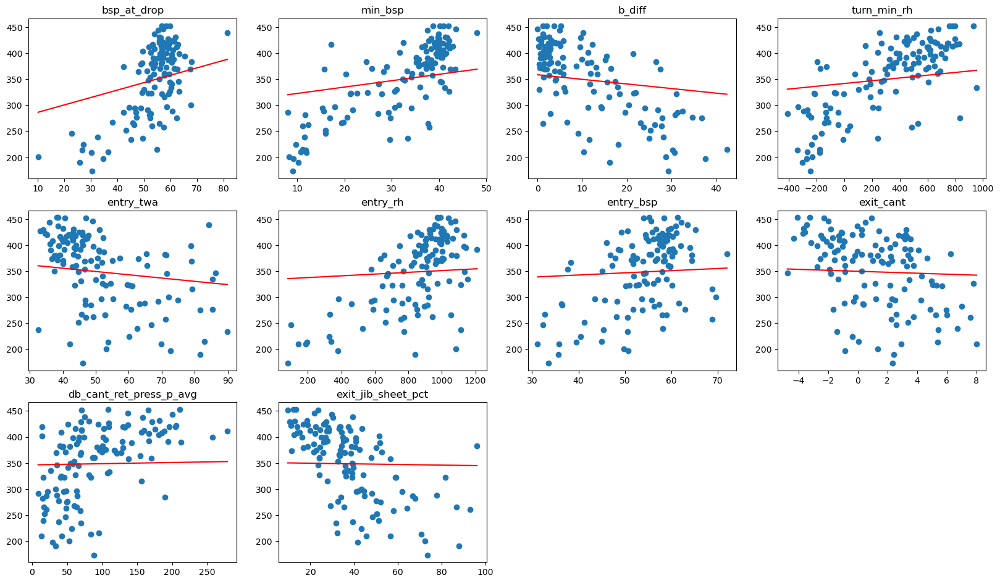

In [37]:
##Visualize the relation
row = len(rank_list)//4 + 1
fig=plt.figure(figsize=(20, row*4))

#for i in range(len(rank_list)):
for i in range(len(X_selected)):
    ax = fig.add_subplot(row, 4, i+1)
    ax.scatter(X[X.columns.values[rank_list[i]]], Y)
    ax.set_title(X.columns.values[rank_list[i]])

    x_ref = np.linspace(X_train[X_train.columns.values[rank_list[i]]].min(), X_train[X_train.columns.values[rank_list[i]]].max(), 100)
    y_ref = coefficients[rank_list[i]] * x_ref
    x_line = x_ref*x[x.columns.values[rank_list[i]]].std() + x[x.columns.values[rank_list[i]]].mean()
    y_line = y_ref*y.std() + y.mean()

    ax.plot(x_line, y_line, color='red')

plt.show()

The coefficient of determination of this model is 0.7, and the big trends of the data became clear with this model. Most of the columns are eliminated because it has too much relations with other columns, or it's not related to the VMGs.

Looking at the scatter graphs above, the variables which related to the entry of the tack looks very crutial for the tacking vmgs. Other features, for example, minimum boat speed or minimum ride hight also looks related but these are the results of how they tacked. Therefore, entering tack with good speed and high ride hight, and dropping the boards with higher speed might results with good VMG tacking. 

## Question 8: Give insights on the racing on what made a team win or underperform in the race.

### Question 8:

I have focused on the variables of boat speed, VMC and distance sailed in each legs of each boats and compared the relationships between the finishing time. Data of race 5 was used for an example and comments at the end.

In [38]:
##Read mark position data of a day
df = pd.read_csv('./Data/Course_Marks_2025-01-19.csv', parse_dates=[0])

time_zone = 'Pacific/Auckland'
df['DATETIME'] = df['DATETIME'].dt.tz_convert(time_zone).dt.tz_localize(None)


##Format dataframe to arrange with the datetime index
racelog_df = pd.DataFrame(df['DATETIME'].unique(), columns=['DATETIME'])


##Append Mark position and TWD data
marktypes = df['MARK'].unique()
for marktype in marktypes:
    append_df = df.query(f'MARK == "{marktype}"')
    append_df = append_df[['DATETIME','LATITUDE_deg','LONGITUDE_deg','TWD_deg']]
    append_df = append_df.rename(columns={'LATITUDE_deg':f'{marktype}_LATITUDE_deg',
                                          'LONGITUDE_deg':f'{marktype}_LONGITUDE_deg',
                                          'TWD_deg':f'{marktype}_TWD_deg'})
    racelog_df = pd.merge(racelog_df, append_df, on='DATETIME')

racelog_df.head()

,DATETIME,FL1_LATITUDE_deg,FL1_LONGITUDE_deg,FL1_TWD_deg,FL2_LATITUDE_deg,FL2_LONGITUDE_deg,FL2_TWD_deg,LG1_LATITUDE_deg,LG1_LONGITUDE_deg,LG1_TWD_deg,...,SL1_TWD_deg,SL2_LATITUDE_deg,SL2_LONGITUDE_deg,SL2_TWD_deg,WG1_LATITUDE_deg,WG1_LONGITUDE_deg,WG1_TWD_deg,WG2_LATITUDE_deg,WG2_LONGITUDE_deg,WG2_TWD_deg
0,2025-01-19 14:00:01,-36.833966,174.767958,69.768609,-36.834070,174.767963,72.499344,-36.833759,174.767951,66.565447,...,61.183081,-36.834832,174.767668,69.103916,-36.834346,174.767942,66.586871,-36.834186,174.767955,68.016785
1,2025-01-19 14:00:02,-36.833969,174.767961,69.792779,-36.834071,174.767962,72.311472,-36.833761,174.767950,66.389660,...,60.952361,-36.834835,174.767670,68.845729,-36.834349,174.767943,66.430860,-36.834188,174.767955,67.781121
2,2025-01-19 14:00:03,-36.833971,174.767961,69.748283,-36.834075,174.767962,72.409253,-36.833763,174.767952,66.561602,...,60.647481,-36.834838,174.767671,68.560625,-36.834349,174.767943,66.020508,-36.834191,174.767955,67.609180
3,2025-01-19 14:00:04,-36.833973,174.767960,69.810907,-36.834076,174.767962,72.475723,-36.833765,174.767953,66.898343,...,60.108036,-36.834843,174.767672,68.309580,-36.834352,174.767944,65.643117,-36.834192,174.767957,67.549303
4,2025-01-19 14:00:05,-36.833976,174.767962,69.999329,-36.834079,174.767964,72.352672,-36.833768,174.767952,67.373516,...,59.570788,-36.834848,174.767675,68.094241,-36.834354,174.767944,65.313517,-36.834195,174.767957,67.537217


In [39]:
COUNTRY_LIST = []

##Read each boat csv logs
for filename in glob.glob(f'./Data/Boat_logs/data_*.csv'):
    COUNTRY_CODE = os.path.basename(filename).split('_')[1].split('.')[0]
    COUNTRY_LIST.append(COUNTRY_CODE)

    boatlog_df = pd.read_csv(filename, parse_dates=[1,2])[['TIME_LOCAL_unk', 'LATITUDE_GPS_unk', 'LONGITUDE_GPS_unk', 'GPS_SOG_km_h_1', 'GPS_COG_deg', 'TRK_LEG_NUM_unk', 'TRK_RACE_NUM_unk']]
    boatlog_df = boatlog_df.rename(columns={'TIME_LOCAL_unk':'DATETIME',
                            'LATITUDE_GPS_unk':f'{COUNTRY_CODE}_LATITUDE',
                            'LONGITUDE_GPS_unk':f'{COUNTRY_CODE}_LONGITUDE',
                            'GPS_SOG_km_h_1':f'{COUNTRY_CODE}_GPS_SOG',
                            'GPS_COG_deg':f'{COUNTRY_CODE}_GPS_COG',
                            'TRK_RACE_NUM_unk':f'{COUNTRY_CODE}_RACE_NUMBER',
                            'TRK_LEG_NUM_unk':f'{COUNTRY_CODE}_LEG_NUMBER'})
    boatlog_df[f'{COUNTRY_CODE}_RACE_NUMBER'] = boatlog_df[f'{COUNTRY_CODE}_RACE_NUMBER'].apply(lambda x: int(str(x)[7]))

    ##merge boat data to the dataframe
    racelog_df = pd.merge(racelog_df, boatlog_df, on='DATETIME', how='left')


##Fill N/A in race_number and leg_number
for COUNTRY_CODE in COUNTRY_LIST:
    racelog_df[f'{COUNTRY_CODE}_LEG_NUMBER'] = racelog_df[f'{COUNTRY_CODE}_LEG_NUMBER'].bfill().fillna(0)
    racelog_df[f'{COUNTRY_CODE}_RACE_NUMBER'] = racelog_df[f'{COUNTRY_CODE}_RACE_NUMBER'].bfill().fillna(0)
    racelog_df = racelog_df.astype({f'{COUNTRY_CODE}_RACE_NUMBER':'int', f'{COUNTRY_CODE}_LEG_NUMBER':'int'})
racelog_df = racelog_df.bfill().ffill()

In [40]:
def markCenterPos(row, mark):
    if len(mark) == 1:
        return [row[f'{mark[0]}_LATITUDE_deg'], row[f'{mark[0]}_LONGITUDE_deg']]
    elif len(mark) == 2:
        return [np.mean([row[f'{mark[0]}_LATITUDE_deg'], row[f'{mark[1]}_LATITUDE_deg']]), np.mean([row[f'{mark[0]}_LONGITUDE_deg'], row[f'{mark[1]}_LONGITUDE_deg']])]

def vmc(df, COUNTRY_LIST):
    mark_list = [['SL1','SL2'],['M1'],['LG1','LG2'],['WG1','WG2'],['LG1','LG2'],['WG1','WG2'],['LG1'],['FL1','FL2']]
    for COUNTRY_CODE in COUNTRY_LIST:
        vmc = []
        azimuth = []
        sog = df[f'{COUNTRY_CODE}_GPS_SOG']
        cog = df[f'{COUNTRY_CODE}_GPS_COG']
        leg = df[f'{COUNTRY_CODE}_LEG_NUMBER']

        for index, row in df.iterrows():
            mark0_pos = markCenterPos(row, mark_list[leg[index]-1])
            mark1_pos = markCenterPos(row, mark_list[leg[index]])
            azi, _, _ = grs80.inv(mark0_pos[1], mark0_pos[0], mark1_pos[1], mark1_pos[0])
            vmc.append(int(sog[index] * np.cos(np.deg2rad(cog[index]-azi))))
            azimuth.append(round(azi, 2))

        append_df = pd.DataFrame([vmc, azimuth], index=[f'{COUNTRY_CODE}_VMC', f'{COUNTRY_CODE}_Mark_Angle']).T
        df = pd.concat([df, append_df], axis=1)
    return df

def saileddistance(df, COUNTRY_LIST):
    for COUNTRY_CODE in COUNTRY_LIST:
        distance = []
        lat = df[f'{COUNTRY_CODE}_LATITUDE']
        lon = df[f'{COUNTRY_CODE}_LONGITUDE']

        for index, row in df.iterrows():
            if index==0: continue
            pos0 = [lat[index-1], lon[index-1]]
            pos1 = [lat[index], lon[index]]
            azi, _, dis = grs80.inv(pos0[1], pos0[0], pos1[1], pos1[0])
            distance.append(round(dis, 2))

        append_df = pd.DataFrame(distance, columns=[f'{COUNTRY_CODE}_Sailed_Distance'])
        df = pd.concat([df, append_df], axis=1)
    return df

racelog_df = vmc(racelog_df, COUNTRY_LIST)
racelog_df = saileddistance(racelog_df, COUNTRY_LIST)
racelog_df.head()

,DATETIME,FL1_LATITUDE_deg,FL1_LONGITUDE_deg,FL1_TWD_deg,FL2_LATITUDE_deg,FL2_LONGITUDE_deg,FL2_TWD_deg,LG1_LATITUDE_deg,LG1_LONGITUDE_deg,LG1_TWD_deg,...,ESP_Sailed_Distance,AUS_Sailed_Distance,BRA_Sailed_Distance,DEN_Sailed_Distance,ITA_Sailed_Distance,USA_Sailed_Distance,GBR_Sailed_Distance,CAN_Sailed_Distance,GER_Sailed_Distance,NZL_Sailed_Distance
0,2025-01-19 14:00:01,-36.833966,174.767958,69.768609,-36.834070,174.767963,72.499344,-36.833759,174.767951,66.565447,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2025-01-19 14:00:02,-36.833969,174.767961,69.792779,-36.834071,174.767962,72.311472,-36.833761,174.767950,66.389660,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2025-01-19 14:00:03,-36.833971,174.767961,69.748283,-36.834075,174.767962,72.409253,-36.833763,174.767952,66.561602,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2025-01-19 14:00:04,-36.833973,174.767960,69.810907,-36.834076,174.767962,72.475723,-36.833765,174.767953,66.898343,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2025-01-19 14:00:05,-36.833976,174.767962,69.999329,-36.834079,174.767964,72.352672,-36.833768,174.767952,67.373516,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [41]:
pd.options.display.precision = 2
COUNTRY_LIST = sorted(COUNTRY_LIST)

## Race number to analyse
R_NUM = 5

data = {}
data['finishtime'] = [racelog_df.query(f'{nat}_RACE_NUMBER == {R_NUM} & {nat}_LEG_NUMBER == 7')['DATETIME'].max() for nat in COUNTRY_LIST]

for LEG in range(1,8):
    data[f'distance_sailed_LEG{LEG}'] = [racelog_df.query(f'{nat}_RACE_NUMBER == {R_NUM} & {nat}_LEG_NUMBER == {LEG}')[f'{nat}_Sailed_Distance'].sum() for nat in COUNTRY_LIST]
    data[f'average_speed_LEG{LEG}'] = [racelog_df.query(f'{nat}_RACE_NUMBER == {R_NUM} & {nat}_LEG_NUMBER == {LEG}')[f'{nat}_GPS_SOG'].mean() for nat in COUNTRY_LIST]
    data[f'average_VMC_LEG{LEG}'] = [racelog_df.query(f'{nat}_RACE_NUMBER == {R_NUM} & {nat}_LEG_NUMBER == {LEG}')[f'{nat}_VMC'].mean() for nat in COUNTRY_LIST]

df = pd.DataFrame(data, index=COUNTRY_LIST)
df

,finishtime,distance_sailed_LEG1,average_speed_LEG1,average_VMC_LEG1,distance_sailed_LEG2,average_speed_LEG2,average_VMC_LEG2,distance_sailed_LEG3,average_speed_LEG3,average_VMC_LEG3,...,average_VMC_LEG4,distance_sailed_LEG5,average_speed_LEG5,average_VMC_LEG5,distance_sailed_LEG6,average_speed_LEG6,average_VMC_LEG6,distance_sailed_LEG7,average_speed_LEG7,average_VMC_LEG7
AUS,2025-01-19 16:16:33,534.98,80.25,76.46,1283.52,75.89,63.10,1881.06,56.01,38.34,...,50.41,1820.72,52.76,37.13,1485.90,73.35,59.85,693.04,51.16,49.20
BRA,2025-01-19 16:17:11,569.02,68.00,65.37,1270.44,55.75,46.49,1769.15,48.13,34.73,...,49.64,1970.94,54.04,35.20,1427.17,70.60,59.47,428.46,55.60,53.67
CAN,NaT,0.00,NaN,NaN,0.00,NaN,NaN,0.00,NaN,NaN,...,NaN,0.00,NaN,NaN,0.00,NaN,NaN,0.00,NaN,NaN
DEN,2025-01-19 16:17:11,532.02,70.73,67.22,1309.99,71.35,57.72,2003.47,51.14,32.31,...,55.30,1942.83,45.41,29.02,1397.39,67.90,58.22,451.02,48.88,38.67
ESP,2025-01-19 16:17:09,628.69,80.45,76.21,1402.06,62.01,46.07,2003.60,51.24,32.69,...,60.90,1779.29,56.38,39.75,1633.94,66.76,48.48,1007.85,59.30,56.61
GBR,2025-01-19 16:16:43,511.55,76.60,75.04,1311.38,73.78,59.98,1854.52,53.87,36.34,...,61.39,1918.85,47.68,30.98,1449.42,75.74,62.57,488.05,48.34,46.14
GER,2025-01-19 16:17:11,579.93,69.21,66.73,1394.85,64.74,48.68,1766.74,49.70,35.72,...,57.82,2107.50,50.84,30.28,1416.42,71.02,59.99,517.52,58.87,57.23
ITA,2025-01-19 16:17:01,614.62,70.97,68.29,1363.81,67.54,52.00,1974.04,49.25,31.81,...,61.40,1976.94,55.20,35.16,1388.58,74.68,64.70,547.94,57.52,53.70
NZL,2025-01-19 16:17:07,516.95,59.34,56.48,1213.67,72.77,63.73,1916.98,48.93,31.84,...,48.02,1920.71,52.68,34.79,1410.09,72.77,61.40,773.09,55.60,53.83
SUI,NaT,543.94,60.55,55.62,1240.17,60.05,50.88,1845.97,47.32,32.50,...,44.21,1974.92,51.45,33.08,1179.29,71.18,59.88,0.00,NaN,NaN


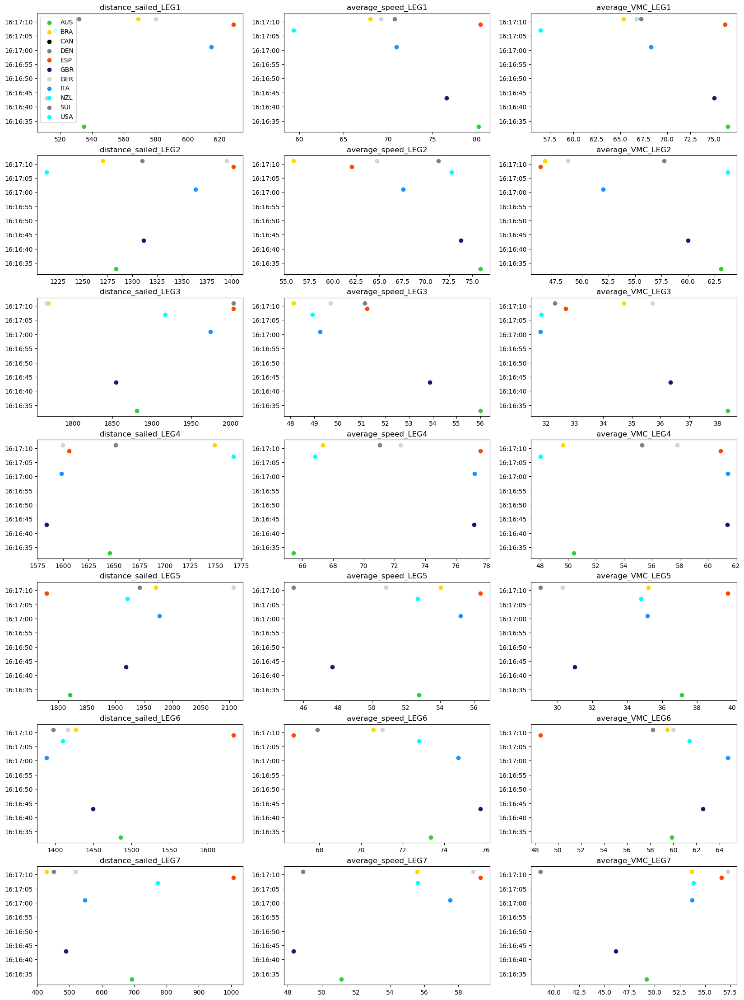

In [42]:
color = {
    'AUS':'limegreen',
    'CAN':'black',
    'GBR':'midnightblue',
    'FRA':'blue',
    'GER':'lightgray',
    'BRA':'gold',
    'NZL':'aqua',
    'ITA':'dodgerblue',
    'DEN':'gray',
    'ESP':'orangered',
    'SUI':'slategray',
    'USA':'cyan'
}

TARGET_COLUMN = 'finishtime'
x = df.drop([TARGET_COLUMN], axis=1)
y = df[TARGET_COLUMN]

##Visualize the relation
row = len(x.columns.values)//3 + 1
fig=plt.figure(figsize=(20, row*4))


for i in range(len(x.columns.values)):
    ax = fig.add_subplot(row, 3, i+1)
    for country in x.index:
        ax.scatter(x[x.columns.values[i]][country], y[country], color=color[country], label=country)
    ax.set_title(x.columns.values[i])
    if i == 0:
        ax.legend(loc='upper left')

plt.show()

In race 5, it looks like the boat which performed well in beginning of the race resulted faster crossing the finish line.

AUS and GBR peformed very well in speed of LEG1 and LEG2, and finished in 1st and 2nd. It is necesary to make a best start in the fleet to perform well in these first 2 legs and they have done it nicely. They also peformed well in LEG3 and extended the lead.

On the other hand, underpeformed team have at least one of slow leg in the race. SUI was struggling to go fast in LEG5 and LEG6 and extended the distance to the fleet. 